In [3]:
import numpy as np
from matplotlib import pyplot as plt
import os
from PIL import Image

In [4]:
# Konstante koje se odnose na dimenzije slika koje koristimo i na broj klasa u problemu
ROWS = 64
COLS = 64
NUM_OF_CHANNELS = 3
NUM_OF_CLASSES = 62
# string gde je i-ti karakter oznaka i-te klase
classes = '0123456789abcdefghijklmnopqrstuvwxyzABCDEFGHIJKLMNOPQRSTUVWXYZ'

In [5]:
# Ova funkcija transformiše sliku sa jednim kanalom oblika (n, m, 1) u rgb sliku oblika (n, m, 3)
def from_grayscale_to_rgb(image):
    return np.stack((image,) * 3, axis=-1)

In [6]:
classes[0]

'0'

In [7]:
# X oznacava naše slike
X = []
# y sadrži odgovarajuće oznake klasa naših slika
y = []

# Pravimo niz koji ce osim klase imati i oznaku da li je to slika, rukopis ili font
y_stratify = []

# Pošto je skup podataka podeljen Na tri dela koja imaju različito organizovane direktorijume
# ovde su navedene sve putanje do direktorijuma u kojima se nalaze slike
file_paths = ['English\Img\GoodImg\Bmp', 'English\Img\BadImag\Bmp', 'English\Hnd\Img', 'English\Fnt']

# otvaramo pojedinacno svaki direktorijum
for path in file_paths:
    # Svi primeri neke klase se nalaze u direktorijumu Sample0X gde je X broj od 1 do 62
    # Tako se na primer sve slike karaktera 'c' nalaze u direktorijumu Sample013.
    stratify_label = ''
    if 'Hnd' in path:
        stratify_label = 'hnd_'
    elif 'Fnt' in path:
        stratify_label = 'fnt_'
    else:
        stratify_label = 'img_'
    
    # Prolazimo kroz sve klase
    for i in range(1, NUM_OF_CLASSES+1):
        # Ako je klasa jednocifren broj onda je oblika Sample00X inace je oblika Sample0XY
        if i < 10:
            directory_name = path + '\Sample00' + str(i) + '\\'
        else:
            directory_name = path + '\Sample0' + str(i) + '\\'

        # Ispis za lakšu preglednost prolaženja kroz fajlove
        print(directory_name)

        # Otvaramo fajlove u zadatom direktorijumu
        files = os.listdir(directory_name)
        for file in files:
            full_file_name = directory_name + file
            
            # Koristimo Image.open() paketa pillow da bismo otvorili sliku
            img = Image.open(full_file_name)
            print(f'OLD_SHAPE: {img.size}')
            # Koristimo resize() metod jer želimo da nam sve slike imaju iste dimenzije
            img_resized = img.resize((ROWS, COLS))
            
            np_img = None
            
            # Pokušamo da pretvorimo sliku u oblik (ROWS, COLS, NUM_OF_CHANNELS)
            # ako to nije uspešno onda pretvaramo sliku u rgb format pa onda radimo 
            # isto. U međuvremenu pretvaramo sliku u numpy niz.
            try:
                np_img = np.reshape(np.asarray(img_resized), (ROWS, COLS, NUM_OF_CHANNELS))
                print(f'NEW_SHAPE: {np_img.shape}')
            except:
                print(f'GRAYSCALE IMAGE SHAPE: {img.size}')
                print(f'GRAYSCALE IMAGE: {np.asarray(img)}')
                img_rgb = from_grayscale_to_rgb(np.asarray(img_resized))
                np_img = np.reshape(img_rgb, (ROWS, COLS, NUM_OF_CHANNELS))
                print(f'CONVERTED TO RGB: {full_file_name}')
                
            # na kraju dodajemo sliku i njenu brojčanu oznaku klase u skup podataka
            X.append(np_img)
            y.append(i-1)
            
            y_stratify.append(stratify_label + str(i-1))

English\Img\GoodImg\Bmp\Sample001\
OLD_SHAPE: (103, 96)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (99, 98)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (86, 122)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (310, 471)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (75, 128)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (76, 127)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (17, 19)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (46, 49)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (55, 66)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 38)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (67, 102)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (79, 89)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (65, 97)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 49)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (33, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (45, 84)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (46, 74)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 78)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (48, 79)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 63)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (12, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (

OLD_SHAPE: (85, 117)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (42, 60)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (127, 182)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (42, 44)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (45, 47)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 51)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (60, 106)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (64, 102)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (71, 112)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (99, 137)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (71, 106)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (67, 102)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (52, 63)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 47)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (46, 75)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 60)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 70)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 66)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 38)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (10, 19)
NEW_SHAPE: (64, 64, 3)
OL

OLD_SHAPE: (142, 155)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (66, 129)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (64, 104)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (61, 106)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 82)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 66)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 71)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 31)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (17, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (13, 31)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 66)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 66)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (70, 132)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 50)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 58)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 56)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (90, 190)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (59, 94)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (53, 99)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 91)
NEW_SHAPE: (64, 64, 3)
OLD_

OLD_SHAPE: (60, 83)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (66, 85)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (56, 42)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (42, 54)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (57, 80)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 77)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (45, 89)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (51, 90)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (84, 163)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (116, 194)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (140, 189)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (87, 82)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 60)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (58, 83)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 74)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (81, 66)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (99, 73)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (38, 57)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (64, 95)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (62, 100)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (54, 100)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (68, 105)
NEW_SHAPE: (64, 64, 3)
OLD

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (159, 145)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (154, 157)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (236, 202)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 52)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (313, 410)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (318, 417)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (158, 236)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (159, 248)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (175, 165)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (141, 115)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (119, 104)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (52, 46)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (58, 39)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (57, 78)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (76, 69)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (57, 69)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 59)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (70, 70)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 44)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (48, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: 

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (179, 141)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (181, 130)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (185, 179)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (66, 102)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (66, 109)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (92, 129)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (69, 95)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (62, 144)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (55, 69)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (63, 81)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (72, 149)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (55, 72)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (107, 293)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 89)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (60, 103)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 33)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 38)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 40)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (54, 75)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (158, 319)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (171, 330)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (2

OLD_SHAPE: (52, 88)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 33)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 38)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 44)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (42, 38)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 41)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 25)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 19)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 64)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 65)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (81, 105)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (63, 88)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (70, 94)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (97, 191)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (113, 189)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (99, 190)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (51, 101)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (55, 121)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (58, 104)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (50, 113)
NEW_SHAPE: (64, 64, 3)
OL

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 34)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 46)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (85, 185)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (87, 215)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (42, 129)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (42, 103)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 98)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 40)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (90, 135)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (64, 97)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (84, 85)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 60)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 58)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (70, 74)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 57)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (70, 94)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (75, 186)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (151, 192)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (170, 187)
N

OLD_SHAPE: (52, 71)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (56, 78)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 53)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (140, 217)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (129, 184)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 66)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (62, 94)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (116, 200)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (124, 144)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (144, 190)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (84, 90)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (83, 83)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (95, 164)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (71, 90)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 42)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (11, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (72, 76)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (40, 36)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 18)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 34)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 23)
NEW_SHAPE: (64, 64, 3)


NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (60, 197)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (54, 183)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (59, 177)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 101)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (62, 129)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 136)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 55)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 49)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 97)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 80)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 92)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 96)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (75, 85)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 46)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 86)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (33, 101)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 114)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 117)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 111)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (37, 126)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 142)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 97)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 68)

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (340, 458)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (84, 89)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (76, 91)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (137, 159)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (55, 46)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (64, 60)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (137, 144)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (153, 179)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (134, 149)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (151, 171)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (12, 16)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 21)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (92, 139)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (78, 93)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (59, 110)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (65, 108)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (56, 107)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (205, 183)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (167, 290)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (79, 98)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (68, 70)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (64, 56)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: 

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (40, 42)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (48, 76)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (40, 59)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (85, 85)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (37, 36)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (81, 125)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 63)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (12, 31)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (13, 23)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (13, 23)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (12, 22)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 20)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 21)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (17, 25)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 56)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (62, 77)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (78, 101)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (55, 91)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (38, 61)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (38, 61)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (46, 62)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 31)
NEW_SHAPE

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (295, 272)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (157, 167)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (142, 155)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (143, 158)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (49, 61)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (51, 61)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (272, 209)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (130, 80)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (92, 85)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (255, 228)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (101, 151)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (71, 100)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 67)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 34)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 32)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 34)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 58)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 52)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 22)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 29)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 30)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (123

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (78, 119)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (40, 63)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 30)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 31)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 25)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (42, 111)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (59, 80)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (191, 323)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (159, 303)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (170, 321)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 38)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 41)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (76, 55)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (12, 19)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 22)
NEW

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (142, 149)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (169, 170)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (122, 96)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (152, 134)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (137, 151)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (163, 172)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (103, 164)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (113, 164)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (95, 161)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (99, 159)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 13)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 52)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 32)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (85, 81)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 20)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 17)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 24)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (42, 74)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 53)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 17)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (56, 71)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (55

OLD_SHAPE: (41, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (58, 84)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 59)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 64)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 60)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (46, 78)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (51, 79)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 50)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 33)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 38)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 34)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (37, 49)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 50)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (51, 53)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 40)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 42)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 75)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 79)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 80)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (38, 79)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (71, 89)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (74, 98)
NEW_SHAPE: (64, 64, 3)
English\Img

OLD_SHAPE: (109, 241)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (110, 236)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (128, 208)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (116, 224)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (108, 115)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (159, 150)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (138, 121)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (105, 127)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (46, 60)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 47)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (33, 51)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 55)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 95)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (97, 86)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (139, 90)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (121, 107)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (56, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (105, 126)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (115, 132)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (95, 63)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (408, 415)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (346, 391)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (337, 382)
NEW_S

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (65, 133)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (197, 209)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (61, 106)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (106, 135)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (121, 190)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (137, 120)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (62, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (103, 152)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (73, 111)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (74, 102)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (53, 98)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (61, 83)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (57, 83)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (56, 71)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (55, 151)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (178, 387)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (111, 188)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (111, 187)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (134, 194)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (46, 77)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (51, 79)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (61, 77)
NEW_SHAPE: (64, 64, 3)
OLD_SHAP

OLD_SHAPE: (54, 64)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (51, 113)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (48, 110)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (83, 212)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (113, 149)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (125, 169)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (137, 220)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (139, 236)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (110, 175)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (133, 191)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (86, 90)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (51, 46)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (106, 169)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (85, 93)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (72, 84)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (71, 116)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (144, 228)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 16)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (51, 104)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 39)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 22)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 24)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 43)
NEW_SHAPE: (6

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (263, 207)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (234, 255)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (146, 153)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (158, 160)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 63)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (217, 220)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (111, 153)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (85, 87)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (218, 245)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (141, 179)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (91, 102)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (52, 40)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (56, 41)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 74)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (56, 86)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 18)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (66, 72)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (56, 57)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 46)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 46)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 46)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 44)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 44)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 36)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 36)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 36)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (125, 157)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (122, 161)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (60, 76)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 34)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 23)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 32)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 36)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (56, 86)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (57, 85)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 40)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (38, 53)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 41)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 39)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 48)
NEW_SHA

OLD_SHAPE: (29, 32)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 83)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (224, 337)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 43)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 42)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 24)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (70, 87)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (100, 76)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (105, 94)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (56, 56)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 29)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 20)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 20)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (85, 83)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 55)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (50, 53)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (33, 24)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (42, 66)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (45, 43)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 41)
NEW_SHAPE: (64, 64, 3)
OLD_SHA

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (50, 94)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 56)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 50)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 47)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (110, 126)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (247, 224)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (74, 97)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (33, 39)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (73, 134)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (88, 147)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (80, 88)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (162, 93)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (163, 236)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (110, 74)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (102, 151)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (208, 313)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (109, 186)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 22)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (127, 194)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 34)
NEW_SHAPE: (64, 64, 3)
English\Img\GoodImg\Bmp\Sample037\
OLD_SHAPE: (29, 29)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 29)
N

OLD_SHAPE: (45, 61)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (7, 22)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 16)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (13, 17)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 17)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (42, 80)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 31)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (71, 83)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (62, 70)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (90, 113)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 36)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (57, 79)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (42, 60)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 60)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 54)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (118, 191)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (92, 125)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 47)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 42)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (210, 239)
NEW_SHAPE: (64, 64, 3)
OLD_SH

OLD_SHAPE: (24, 40)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (89, 113)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (67, 103)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (54, 92)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 44)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (10, 21)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 33)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 38)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 41)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 72)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (156, 163)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (157, 164)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (71, 80)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (69, 84)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (66, 68)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (58, 67)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (61, 71)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (62, 84)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (66, 76)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (61, 83)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (65, 74)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (81, 101)
NEW_SHAPE: (64, 64, 3)
OLD_

OLD_SHAPE: (45, 68)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (7, 23)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (5, 24)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (9, 23)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (9, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (13, 24)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (11, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 49)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 50)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (7, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 76)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 75)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (5, 34)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (6, 22)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (10, 23)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (9, 24)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (8, 22)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (17, 59)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 58)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (13, 54)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (88, 188)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 46)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 54)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 133

OLD_SHAPE: (31, 42)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (33, 47)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 46)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 47)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (199, 185)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (184, 189)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (96, 100)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (315, 355)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (430, 391)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (53, 64)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (93, 71)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (74, 68)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (112, 129)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (98, 79)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 44)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 49)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 29)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (52, 76)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 36)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (67, 60)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 104)
NEW_SHAPE: (64, 64, 3)

OLD_SHAPE: (78, 102)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (49, 51)
NEW_SHAPE: (64, 64, 3)
English\Img\GoodImg\Bmp\Sample052\
OLD_SHAPE: (129, 193)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 41)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (48, 76)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (137, 172)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (92, 141)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (74, 117)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (56, 159)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (12, 17)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (10, 18)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 30)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 24)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (42, 86)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (156, 250)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (57, 77)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (54, 87)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (101, 155)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (42, 60)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 53)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (178, 172)
NEW_SHAPE: (64, 64, 3)
OLD_S

OLD_SHAPE: (52, 65)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (316, 291)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (100, 111)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (66, 69)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (116, 148)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 38)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (51, 149)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (38, 49)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (104, 177)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (90, 144)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (115, 150)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (73, 88)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 20)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 21)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 29)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 33)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (13, 16)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 38)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 32)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (38, 36)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (11, 14)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 28)
NEW_SHAPE: (64, 64, 3)

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (59, 81)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (60, 94)
NEW_SHAPE: (64, 64, 3)
English\Img\GoodImg\Bmp\Sample059\
OLD_SHAPE: (132, 87)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (127, 90)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (131, 97)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (58, 49)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (215, 167)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (348, 223)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (123, 95)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (124, 96)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (125, 96)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (96, 85)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (70, 111)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (42, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 20)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (42, 32)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 17)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (52, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (52, 39)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (54, 25)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 23)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (37, 24)
NEW_SHAP

OLD_SHAPE: (22, 49)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 52)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (76, 162)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (11, 21)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 23)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (10, 22)
NEW_SHAPE: (64, 64, 3)
English\Img\BadImag\Bmp\Sample003\
OLD_SHAPE: (48, 58)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 42)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 46)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 62)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 58)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (42, 33)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 38)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 43)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 21)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (94, 108)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (66, 117)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (63, 103)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (50, 101)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 82)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (51, 76)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (63

OLD_SHAPE: (13, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (17, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 49)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (151, 192)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (99, 102)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (12, 22)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 23)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 21)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 76)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 83)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (46, 74)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (153, 229)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (139, 151)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (118, 166)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (125, 188)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (124, 257)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (86, 127)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (79, 102)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (12, 15)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (9, 16)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (8, 13)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (13, 17)
NEW_SHAPE: (64, 64, 3

OLD_SHAPE: (107, 197)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (116, 215)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (38, 99)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 101)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (40, 92)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (48, 94)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 95)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 36)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 29)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 33)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 29)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 32)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 34)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (88, 78)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 24)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (33, 57)
NEW_SHAPE: (64, 64, 3)
English\Img\BadImag\Bmp\Sample012\
OLD_SHAPE: (32, 39)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (58, 52)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 41)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (95, 131)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (67, 69)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (17, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (56, 98)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (65, 80)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (45, 52)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (152, 239)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 60)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (90, 90)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 39)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 56)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (40, 55)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (48, 69)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (45, 69)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 58)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 52)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (195, 281)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (37, 70)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 78)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (63, 142)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (37, 128)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (46, 142)
NEW

OLD_SHAPE: (86, 203)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (85, 205)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (61, 93)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (53, 89)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (60, 90)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 63)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (54, 155)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 163)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (54, 157)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (64, 188)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (67, 176)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (86, 178)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (84, 194)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (97, 191)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (69, 167)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (37, 109)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (61, 117)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (52, 122)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (52, 139)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (96, 212)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 70)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 83)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (38, 89)
NEW_SHAPE: (64, 64

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 149)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 62)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (63, 88)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (129, 162)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (164, 193)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (68, 175)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (123, 191)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (118, 193)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (121, 192)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 60)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 50)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (38, 55)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (52, 73)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (48, 51)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (52, 83)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (50, 94)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (66, 99)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (74, 81)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (72, 83)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (59, 68)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (62, 73)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (136, 192)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (63, 1

OLD_SHAPE: (78, 205)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 47)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 74)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 32)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (50, 82)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (80, 73)
NEW_SHAPE: (64, 64, 3)
English\Img\BadImag\Bmp\Sample021\
OLD_SHAPE: (128, 219)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (82, 112)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (75, 115)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (53, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (131, 114)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (33, 43)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (134, 87)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 61)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (17, 20)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (71, 92)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (81, 65)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 36)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: 

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (50, 95)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (42, 93)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (50, 75)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (71, 75)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (65, 78)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (145, 203)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (57, 88)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (58, 81)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (68, 66)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 25)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (118, 122)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 18)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 21)
NEW_SHAPE: (64, 64, 3)
English\Img\BadImag\Bmp\Sample024\
OLD_SHAPE: (79, 99)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (153, 221)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (138, 221)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (79, 118)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (75, 106)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (109, 58)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (45, 47)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (45, 46)
NEW_SHAP

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 32)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 54)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (17, 60)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 75)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 76)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 51)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (52, 47)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 55)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 42)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 36)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (58, 70)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (62, 78)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (104, 71)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (33, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 43)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (33, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 43)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 24)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (12, 20)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (12, 14)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (13, 16)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (38, 51)
NEW_SHAPE:

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 54)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (138, 206)
NEW_SHAPE: (64, 64, 3)
English\Img\BadImag\Bmp\Sample028\
OLD_SHAPE: (118, 138)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (64, 111)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (134, 210)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (69, 108)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (92, 125)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (92, 128)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (46, 62)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (76, 94)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (42, 46)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 47)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 40)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 46)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (70, 94)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (46, 58)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (42, 59)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (54, 78)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (67, 44)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 24)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 23)
NEW_SHAPE

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 55)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 58)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (38, 61)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (86, 164)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (75, 84)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (75, 80)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 46)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (17, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (40, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 21)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 36)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 29)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 57)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 52)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 56)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (52, 71)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 52)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 64)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 25)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 47)
NEW_SHAPE:

OLD_SHAPE: (18, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 24)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 23)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 25)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (12, 29)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (54, 104)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (86, 133)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 54)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 40)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 33)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (10, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (10, 36)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (13, 34)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 93)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (52, 98)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (70, 112)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 22)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (13, 17)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 18)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (40, 47)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 50)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (11, 19)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (10, 15)
NEW_SHAPE: (64, 64, 3)
OLD_SHAP

OLD_SHAPE: (20, 20)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (85, 75)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (62, 87)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (172, 96)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 55)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (67, 103)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 25)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 38)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (77, 105)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 16)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (56, 62)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (87, 92)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (68, 97)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (49, 62)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (38, 65)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (251, 199)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (115, 150)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (93, 162)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (114, 121)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (73, 87)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (72, 76)
NEW_SHAPE: (64, 64, 3)
O

OLD_SHAPE: (17, 33)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (52, 42)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 55)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 43)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (79, 97)
NEW_SHAPE: (64, 64, 3)
English\Img\BadImag\Bmp\Sample040\
OLD_SHAPE: (79, 130)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (72, 97)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (72, 109)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 25)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 60)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 57)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 57)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (54, 85)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (52, 73)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (72, 52)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 19)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (17, 33)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (17, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 23)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (102, 169)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (11, 22)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (10,

OLD_SHAPE: (47, 77)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (49, 84)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 42)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 31)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 32)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (37, 67)
NEW_SHAPE: (64, 64, 3)
English\Img\BadImag\Bmp\Sample045\
OLD_SHAPE: (8, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 42)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (70, 24)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 121)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (40, 124)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 99)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 73)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (159, 217)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (155, 223)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (97, 196)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 83)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (12, 49)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (49, 23)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (198, 54)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (90, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (

OLD_SHAPE: (31, 31)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 43)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 49)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (165, 185)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (37, 51)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (53, 69)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (45, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (146, 85)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 22)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (66, 52)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (84, 58)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 19)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (10, 20)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (12, 21)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 23)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (12, 21)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 20)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 17)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 16)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (80, 121)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 25)
NEW_SHAPE: (64, 64, 3)
OLD_SHA

OLD_SHAPE: (19, 34)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 34)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 50)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (59, 79)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (7, 15)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (7, 16)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (8, 14)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (65, 67)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 57)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 94)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 98)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (54, 96)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 64)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 61)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 58)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 69)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (89, 129)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (46, 135)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (50, 131)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (92, 194)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 99)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE:

OLD_SHAPE: (61, 99)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (56, 59)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 90)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (54, 44)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (48, 66)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (33, 51)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 55)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 52)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (53, 52)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 80)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (38, 50)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (11, 19)
NEW_SHAPE: (64, 64, 3)
English\Img\BadImag\Bmp\Sample058\
OLD_SHAPE: (59, 36)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (13, 12)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 42)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (10, 14)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (8, 13)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 39)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (67, 79)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 46)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (110, 125

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
English\Hnd\Img\Sample003\
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHA

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: 

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
English\Hnd\Img\Sample010\
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHA

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: 

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
English\Hnd\Img\Sample017\
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHA

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: 

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
English\Hnd\Img\Sample024\
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHA

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
English\Hnd\Img\Sample027\
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHA

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: 

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: 

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
English\Hnd\Img\Sample037\
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHA

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: 

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
English\Hnd\Img\Sample044\
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHA

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: 

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: 

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
English\Hnd\Img\Sample054\
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHA

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: 

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
English\Hnd\Img\Sample061\
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHA

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00179.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00180.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00181.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00395.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00396.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00397.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00583.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00584.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00585.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00760.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00761.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00762.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00824.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00825.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00826.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-01015.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-01016.png
English\Fnt\Sample002\
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00001.png
OLD_SHAPE: 

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00186.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00187.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00188.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00394.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00395.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00396.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00602.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00603.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00604.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00767.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00768.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00769.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00940.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00941.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00942.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00062.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00063.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00064.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00262.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00263.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00264.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00472.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00473.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00474.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00688.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00689.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00690.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample003\img003-00889.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00890.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00891.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00054.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00055.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00056.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample004\img004-00266.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00267.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00268.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00465.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00466.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00467.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample004\img004-00627.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00628.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00629.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample004\img004-00827.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00828.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00829.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00001.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00002.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00003.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00201.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00202.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00203.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00377.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00378.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00379.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00572.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00573.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00574.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00771.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00772.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00773.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00949.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00950.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00951.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00087.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00088.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00089.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00294.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00295.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00296.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00513.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00514.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00515.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample006\img006-00723.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00724.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00725.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample006\img006-00944.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00945.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00946.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00112.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00113.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00114.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample007\img007-00322.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00323.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00324.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00527.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00528.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00529.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00733.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00734.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00735.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00937.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00938.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00939.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00097.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00098.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00099.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00297.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00298.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00299.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample008\img008-00504.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00505.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00506.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00707.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00708.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00709.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00931.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00932.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00933.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample009\img009-00093.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00094.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00095.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00297.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00298.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00299.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00522.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00523.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00524.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00733.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00734.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00735.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00919.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00920.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00921.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample010\img010-00092.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00093.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00094.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00292.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00293.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00294.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00508.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00509.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00510.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00710.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00711.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00712.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00926.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00927.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00928.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00098.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00099.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00100.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample011\img011-00316.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00317.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00318.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00527.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00528.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00529.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample011\img011-00742.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00743.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00744.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample011\img011-00955.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00956.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00957.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00112.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00113.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00114.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00322.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00323.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00324.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample012\img012-00523.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00524.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00525.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00718.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00719.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00720.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample012\img012-00911.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00912.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00913.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample013\img013-00067.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00068.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00069.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00266.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00267.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00268.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00466.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00467.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00468.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00674.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00675.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00676.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00867.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00868.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00869.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00022.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00023.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00024.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00220.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00221.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00222.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample014\img014-00406.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00407.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00408.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00604.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00605.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00606.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00816.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00817.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00818.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00001.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00002.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00003.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00201.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00202.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00203.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00423.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00424.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00425.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00648.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00649.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00650.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00864.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00865.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00866.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00048.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00049.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00050.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00266.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00267.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00268.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


CONVERTED TO RGB: English\Fnt\Sample016\img016-00491.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00492.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00493.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample016\img016-00717.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00718.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00719.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00926.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00927.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00928.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


CONVERTED TO RGB: English\Fnt\Sample017\img017-00102.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00103.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00104.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00311.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00312.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00313.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample017\img017-00526.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00527.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00528.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00746.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00747.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00748.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00961.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00962.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00963.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00139.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00140.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00141.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample018\img018-00365.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00366.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00367.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00581.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00582.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00583.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00802.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00803.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00804.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00001.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00002.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00003.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample019\img019-00221.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00222.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00223.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00445.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00446.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00447.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00671.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00672.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00673.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00894.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00895.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00896.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00072.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00073.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00074.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00289.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00290.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00291.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample020\img020-00491.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00492.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00493.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00715.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00716.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00717.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00925.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00926.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00927.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00095.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00096.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00097.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample021\img021-00300.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00301.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00302.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample021\img021-00514.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00515.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00516.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample021\img021-00730.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00731.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00732.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00943.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00944.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00945.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00117.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00118.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00119.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample022\img022-00337.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00338.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00339.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00567.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00568.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00569.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample022\img022-00789.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00790.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00791.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample022\img022-01009.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-01010.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-01011.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00190.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00191.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00192.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00406.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00407.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00408.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00614.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00615.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00616.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00824.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00825.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00826.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00001.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00002.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00003.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample024\img024-00202.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00203.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00204.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00422.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00423.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00424.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample024\img024-00634.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00635.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00636.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00824.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00825.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00826.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00998.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00999.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-01000.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample025\img025-00141.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00142.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00143.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00339.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00340.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00341.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00545.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00546.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00547.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


CONVERTED TO RGB: English\Fnt\Sample025\img025-00758.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00759.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00760.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00968.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00969.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00970.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00135.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00136.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00137.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00318.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00319.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00320.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00496.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00497.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00498.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00672.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00673.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00674.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00881.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00882.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00883.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample027\img027-00033.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00034.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00035.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00238.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00239.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00240.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00444.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00445.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00446.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample027\img027-00651.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00652.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00653.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00859.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00860.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00861.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00026.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00027.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00028.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample028\img028-00225.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00226.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00227.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample028\img028-00415.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00416.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00417.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample028\img028-00602.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00603.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00604.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00793.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00794.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00795.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample028\img028-00982.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00983.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00984.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample029\img029-00126.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00127.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00128.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample029\img029-00327.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00328.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00329.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00514.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00515.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00516.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00714.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00715.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00716.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00899.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00900.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00901.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00051.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00052.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00053.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00251.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00252.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00253.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00462.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00463.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00464.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample030\img030-00692.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00693.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00694.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00907.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00908.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00909.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00085.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00086.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00087.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample031\img031-00298.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00299.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00300.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample031\img031-00512.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00513.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00514.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00706.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00707.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00708.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample031\img031-00914.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00915.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00916.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00070.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00071.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00072.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample032\img032-00289.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00290.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00291.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00492.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00493.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00494.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample032\img032-00707.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00708.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00709.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00922.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00923.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00924.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00084.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00085.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00086.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00297.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00298.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00299.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00507.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00508.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00509.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample033\img033-00717.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00718.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00719.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample033\img033-00927.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00928.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00929.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample034\img034-00101.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00102.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00103.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00315.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00316.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00317.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample034\img034-00522.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00523.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00524.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00738.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00739.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00740.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00947.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00948.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00949.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00123.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00124.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00125.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample035\img035-00325.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00326.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00327.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00540.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00541.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00542.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00755.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00756.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00757.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00968.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00969.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00970.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00139.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00140.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00141.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00349.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00350.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00351.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00565.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00566.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00567.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample036\img036-00774.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00775.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00776.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00989.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00990.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00991.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00155.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00156.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00157.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00363.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00364.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00365.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00571.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00572.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00573.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00779.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00780.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00781.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00987.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00988.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00989.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00154.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00155.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00156.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00364.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00365.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00366.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00579.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00580.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00581.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00787.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00788.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00789.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00978.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00979.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00980.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00133.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00134.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00135.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00342.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00343.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00344.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00554.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00555.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00556.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00762.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00763.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00764.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00974.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00975.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00976.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00140.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00141.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00142.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample040\img040-00346.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00347.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00348.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00560.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00561.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00562.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00770.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00771.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00772.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00990.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00991.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00992.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00156.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00157.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00158.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00372.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00373.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00374.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00579.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00580.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00581.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00793.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00794.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00795.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


CONVERTED TO RGB: English\Fnt\Sample041\img041-01011.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-01012.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-01013.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00181.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00182.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00183.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00387.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00388.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00389.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00599.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00600.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00601.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00814.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00815.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00816.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-01013.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-01014.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-01015.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00179.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00180.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00181.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00387.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00388.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00389.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00595.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00596.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00597.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample043\img043-00780.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00781.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00782.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00972.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00973.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00974.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00117.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00118.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00119.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00287.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00288.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00289.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00487.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00488.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00489.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00684.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00685.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00686.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample044\img044-00855.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00856.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00857.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-01008.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-01009.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-01010.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00160.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00161.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00162.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

CONVERTED TO RGB: English\Fnt\Sample045\img045-00362.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00363.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00364.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00559.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00560.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00561.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample045\img045-00739.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00740.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00741.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample045\img045-00922.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00923.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00924.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00090.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00091.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00092.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00298.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00299.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00300.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample046\img046-00512.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00513.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00514.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00716.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00717.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00718.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


CONVERTED TO RGB: English\Fnt\Sample046\img046-00930.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00931.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00932.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00100.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00101.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00102.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00310.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00311.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00312.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00521.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00522.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00523.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample047\img047-00706.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00707.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00708.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00912.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00913.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00914.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00078.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00079.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00080.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00301.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00302.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00303.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample048\img048-00525.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00526.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00527.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00746.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00747.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00748.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00968.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00969.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00970.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00148.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00149.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00150.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00360.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00361.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00362.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample049\img049-00572.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00573.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00574.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00780.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00781.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00782.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00994.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00995.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00996.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample050\img050-00165.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00166.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00167.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample050\img050-00383.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00384.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00385.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00597.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00598.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00599.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample050\img050-00816.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00817.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00818.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00001.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00002.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00003.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00204.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00205.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00206.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00415.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00416.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00417.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00627.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00628.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00629.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00841.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00842.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00843.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample052\img052-00012.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00013.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00014.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00225.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00226.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00227.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00437.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00438.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00439.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00650.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00651.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00652.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00862.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00863.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00864.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00034.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00035.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00036.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

CONVERTED TO RGB: English\Fnt\Sample053\img053-00230.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00231.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00232.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample053\img053-00447.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00448.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00449.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00653.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00654.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00655.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


CONVERTED TO RGB: English\Fnt\Sample053\img053-00850.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00851.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00852.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample054\img054-00018.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00019.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00020.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00228.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00229.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00230.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample054\img054-00420.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00421.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00422.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample054\img054-00628.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00629.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00630.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00841.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00842.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00843.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00009.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00010.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00011.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample055\img055-00222.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00223.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00224.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00428.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00429.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00430.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00625.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00626.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00627.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

CONVERTED TO RGB: English\Fnt\Sample055\img055-00838.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00839.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00840.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00009.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00010.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00011.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00226.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00227.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00228.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00438.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00439.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00440.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00647.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00648.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00649.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00862.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00863.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00864.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00021.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00022.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00023.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


CONVERTED TO RGB: English\Fnt\Sample057\img057-00213.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00214.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00215.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00419.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00420.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00421.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample057\img057-00623.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00624.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00625.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00838.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00839.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00840.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00006.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00007.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00008.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample058\img058-00217.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00218.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00219.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00425.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00426.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00427.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00635.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00636.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00637.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00843.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00844.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00845.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00001.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00002.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00003.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00193.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00194.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00195.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00339.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00340.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00341.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00515.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00516.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00517.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00703.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00704.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00705.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00899.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00900.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00901.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample060\img060-00055.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00056.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00057.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample060\img060-00244.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00245.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00246.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample060\img060-00436.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00437.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00438.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample060\img060-00632.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00633.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00634.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample060\img060-00830.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00831.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00832.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00001.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00002.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00003.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample061\img061-00218.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00219.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00220.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00427.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00428.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00429.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


CONVERTED TO RGB: English\Fnt\Sample061\img061-00643.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00644.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00645.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample061\img061-00852.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00853.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00854.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00027.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00028.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00029.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00236.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00237.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00238.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00449.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00450.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00451.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00663.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00664.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00665.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00883.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00884.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00885.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

In [8]:
# Pomoćni kod koji prolazi kroz skup podataka i proverava da li sve slike imaju zadati oblik
for i, el in enumerate(X):
    if el.shape != (64, 64, 3):
        print(f'Error at index {i}!') 

In [9]:
# Pretvaramo niz u numpy niz
X = np.array(X)
y = np.array(y)
y_stratify = np.array(y_stratify)

In [10]:
X.shape

(78905, 64, 64, 3)

In [11]:
y.shape

(78905,)

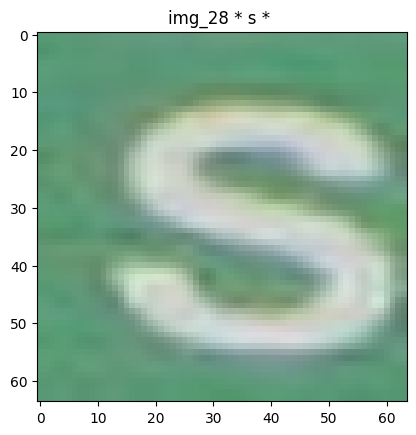

In [12]:
# Proveravamo da li se oznake klasa poklapaju sa slikom
plt.imshow(X[5000])
plt.title(y_stratify[5000] + ' * ' + classes[y[5000]] + ' * ')
plt.show()

In [13]:
from sklearn.model_selection import train_test_split

In [14]:
# Da bismo dobili sve jedinstvene vrednosti liste y_stratify koristimo klasu Counter iz paketa
# collections
from collections import Counter

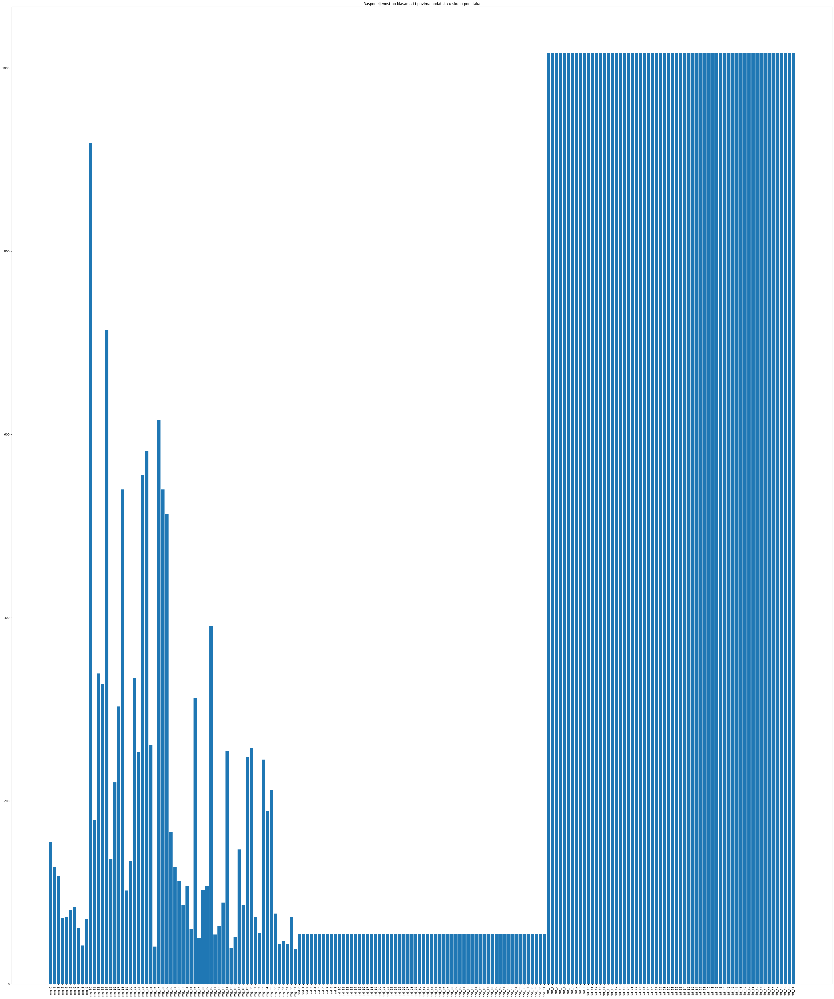

In [15]:
# Gledamo kako su podaci raspodeljeni ne samo po klasama već i po tipovima slika i vidimo da 
# dominiraju slike fontova i da je najmanje slika rukom pisanih karaktera.
plt.figure(figsize=(50, 60))
column_names = Counter(y_stratify).keys()
column_values = Counter(y_stratify).values()
plt.title('Raspodeljenost po klasama i tipovima podataka u skupu podataka')
plt.bar(column_names, column_values)
plt.xticks(range(len(column_names)), column_names, rotation=90)

#plt.savefig('data_distribution_by_class_and_type.png', dpi=300)

plt.show()

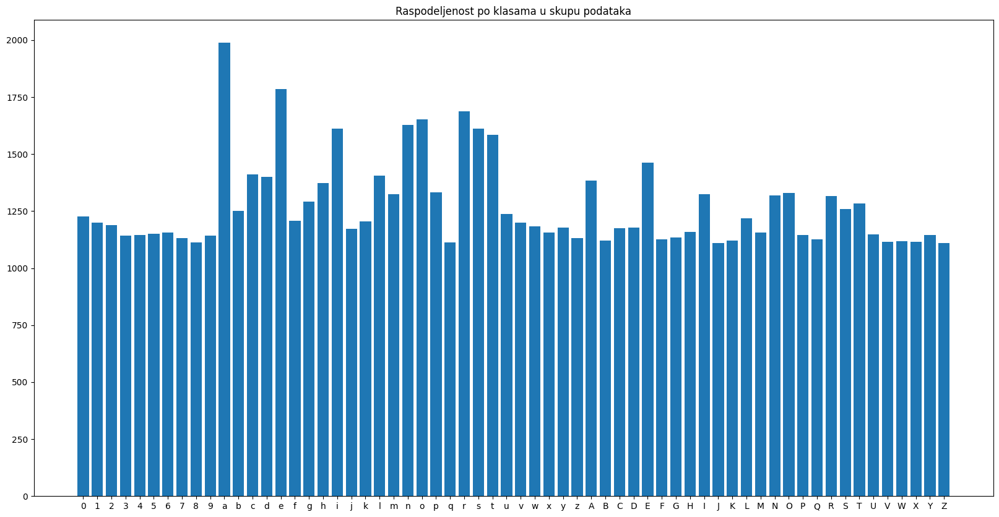

In [16]:
# Gledamo kako su raspoređene instance po klasama u skupu podataka.
# Vidimo da su manje više jednako raspoređene iako nekih ima malo više, ipak ne
# postoji neka klasa koja je jako malo zastupljena, pa ne moramo da vršimo semplovanje
# ili dodavanje posebnih težina.
plt.figure(figsize=(20, 10))
plt.title('Raspodeljenost po klasama u skupu podataka')
plt.bar([classes[el] for el in np.unique(y)], np.bincount(y))

#plt.savefig('data_distribution_by_class.png', dpi=300)
plt.show()

In [17]:
# Delimo podatke na trening i test u odnosu 2:1 i vršimo stratifikaciju po klasama
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, stratify=y_stratify, random_state=7)

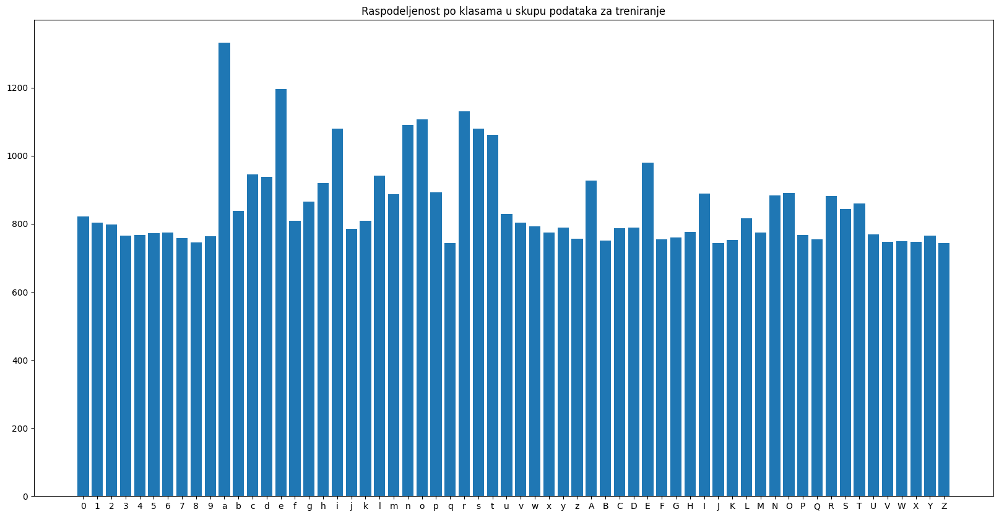

In [18]:
plt.figure(figsize=(20, 10))
plt.title('Raspodeljenost po klasama u skupu podataka za treniranje')
plt.bar([classes[el] for el in np.unique(y_train)], np.bincount(y_train))
plt.show()

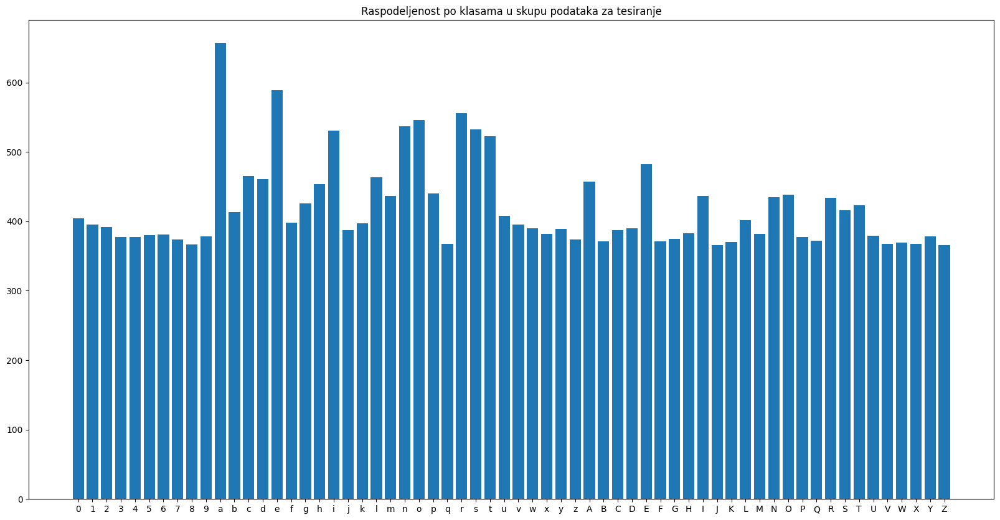

In [19]:
plt.figure(figsize=(20, 10))
plt.title('Raspodeljenost po klasama u skupu podataka za tesiranje')
plt.bar([classes[el] for el in np.unique(y_test)], np.bincount(y_test))
plt.show()

In [20]:
# Skaliramo vrednosti u pikselima iz celobrojnog opsega [0, 255] na decimalni opseg [0.0, 1.0]
X_train = X_train / 255.0
X_test = X_test / 255.0

In [21]:
np.max(X_train)

1.0

In [22]:
y_train.shape

(52866,)

In [23]:
X_train.shape

(52866, 64, 64, 3)

In [24]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Input, Conv2D, MaxPool2D, Dense, Dropout, Flatten, BatchNormalization
from tensorflow.keras import utils
from tensorflow.keras.optimizers import Adam
from tensorflow.keras import regularizers

In [25]:
# Pretvaramo oznake klasa iz numeričkih vrednosti u binarne vektore za potrebe treniranja
y_train = utils.to_categorical(y_train, 62)
y_test = utils.to_categorical(y_test, 62)

In [26]:
# Pravimo model 
model = Sequential([
    Conv2D(128, kernel_size=(3,3), strides=(1,1), padding='same', activation='relu', input_shape=(ROWS, COLS, NUM_OF_CHANNELS)),
    Conv2D(64, kernel_size=(3,3), strides=(1,1), padding='same', activation='relu'),
    MaxPool2D(pool_size=(2,2)),
    Dropout(0.5),
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.5),
    Dense(NUM_OF_CLASSES, activation='softmax')
])

In [51]:
# Druga isprobana arhitektura

model = Sequential([
    Conv2D(96, kernel_size=(11,11), strides=(1,1), padding='same', activation='relu', input_shape=(ROWS, COLS, NUM_OF_CHANNELS)),
    MaxPool2D(pool_size=(3,3), strides=(2,2)),
    Conv2D(256, kernel_size=(5,5), strides=(1,1), padding='same', activation='relu'),
    MaxPool2D(pool_size=(3,3), strides=(2,2)),
    Conv2D(384, kernel_size=(3,3), strides=(1,1), padding='same', activation='relu'),
    Conv2D(384, kernel_size=(3,3), strides=(1,1), padding='same', activation='relu'),
    Conv2D(256, kernel_size=(3,3), strides=(1,1), padding='same', activation='relu'),
    MaxPool2D(pool_size=(3,3), strides=(2,2)),
    Flatten(),
    Dropout(0.5),
    Dense(4096, activation='relu'),
    Dropout(0.5),
    Dense(4096, activation='relu'),
    Dense(NUM_OF_CLASSES, activation='softmax')
])

In [52]:
model.summary()

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_37 (Conv2D)           (None, 64, 64, 96)        34944     
_________________________________________________________________
max_pooling2d_22 (MaxPooling (None, 31, 31, 96)        0         
_________________________________________________________________
conv2d_38 (Conv2D)           (None, 31, 31, 256)       614656    
_________________________________________________________________
max_pooling2d_23 (MaxPooling (None, 15, 15, 256)       0         
_________________________________________________________________
conv2d_39 (Conv2D)           (None, 15, 15, 384)       885120    
_________________________________________________________________
conv2d_40 (Conv2D)           (None, 15, 15, 384)       1327488   
_________________________________________________________________
conv2d_41 (Conv2D)           (None, 15, 15, 256)      

In [53]:
EPOCHS = 50
BATCH_SIZE = 128

In [54]:
model.compile(loss='categorical_crossentropy', optimizer=Adam(0.001), metrics=['accuracy'])

In [55]:
# Treniramo model
history = model.fit(X_train, y_train, batch_size=BATCH_SIZE, epochs=EPOCHS, validation_split=0.2, verbose=1)

Epoch 1/50
331/331 [==============================] - 71s 189ms/step - loss: 2.1709 - accuracy: 0.4367 - val_loss: 0.9633 - val_accuracy: 0.7223
Epoch 2/50
331/331 [==============================] - 57s 172ms/step - loss: 0.9157 - accuracy: 0.7200 - val_loss: 0.6711 - val_accuracy: 0.7866
Epoch 3/50
331/331 [==============================] - 57s 172ms/step - loss: 0.7159 - accuracy: 0.7636 - val_loss: 0.6373 - val_accuracy: 0.7951
Epoch 4/50
331/331 [==============================] - 57s 172ms/step - loss: 0.6318 - accuracy: 0.7885 - val_loss: 0.5401 - val_accuracy: 0.8166
Epoch 5/50
331/331 [==============================] - 57s 172ms/step - loss: 0.5593 - accuracy: 0.8077 - val_loss: 0.5074 - val_accuracy: 0.8281
Epoch 6/50
331/331 [==============================] - 57s 172ms/step - loss: 0.5253 - accuracy: 0.8154 - val_loss: 0.4711 - val_accuracy: 0.8378
Epoch 7/50
331/331 [==============================] - 59s 177ms/step - loss: 0.4935 - accuracy: 0.8235 - val_loss: 0.4548 - val_ac

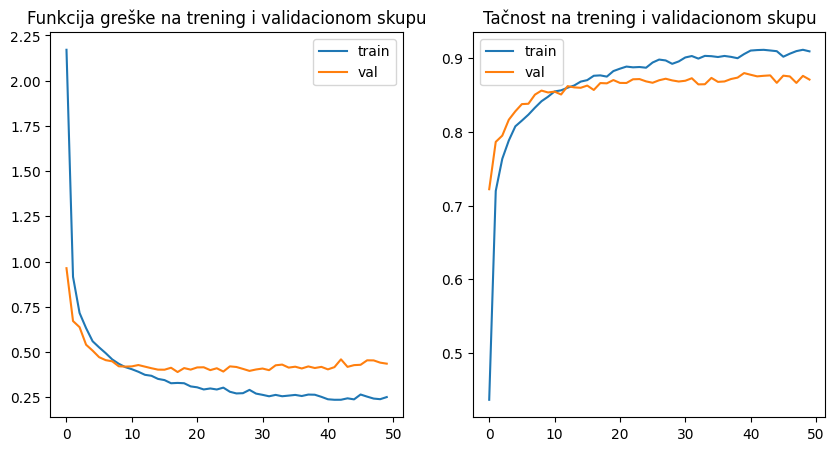

In [56]:
# Posle obučavanja modela prikazujemo funckiju greške i tačnost na trening i validacionom
# skupu kroz epohe.
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.title('Funkcija greške na trening i validacionom skupu')
plt.plot(history.epoch, history.history['loss'], label='train')
plt.plot(history.epoch, history.history['val_loss'], label='val')
plt.legend(loc='best')

plt.subplot(1, 2, 2)
plt.title('Tačnost na trening i validacionom skupu')
plt.plot(history.epoch, history.history['accuracy'], label='train')
plt.plot(history.epoch, history.history['val_accuracy'], label='val')
plt.legend(loc='best')

# U slučaju da želite da sačuvate sliku grafika otkomentarišite liniju ispod
plt.savefig('architecture2_50epochs_bsize_128.png')

plt.show()

In [57]:
# Evaluiramo model na test podacima
model.evaluate(X_test, y_test)

814/814 [==============================] - 15s 16ms/step - loss: 0.4164 - accuracy: 0.8751


[0.4164368212223053, 0.8750720024108887]

In [58]:
from sklearn.metrics import confusion_matrix, classification_report

In [59]:
# Predviđene vrednosti modela za test podatke
y_pred = model.predict(X_test)

In [60]:
# Vraćamo nazad na numeričke vrednosti umesto binarnih vektora
y_pred_numeric = np.argmax(y_pred, axis=1)
y_test_numeric = np.argmax(y_test, axis=1)

In [61]:
# Pišemo izveštaj kalsifikacije da bismo videli neke napredne statistike o klasifikovanju
print(classification_report(y_test_numeric, y_pred_numeric))

              precision    recall  f1-score   support

           0       0.68      0.73      0.71       404
           1       0.94      0.77      0.85       395
           2       0.98      0.96      0.97       392
           3       0.98      0.98      0.98       377
           4       0.99      0.98      0.98       377
           5       0.98      0.97      0.98       380
           6       0.98      0.99      0.99       381
           7       0.97      0.99      0.98       374
           8       0.97      0.98      0.97       367
           9       0.95      0.96      0.96       378
          10       0.95      0.93      0.94       657
          11       0.94      0.95      0.95       413
          12       0.70      0.84      0.76       465
          13       0.94      0.92      0.93       461
          14       0.90      0.96      0.93       589
          15       0.94      0.92      0.93       398
          16       0.93      0.93      0.93       426
          17       0.91    

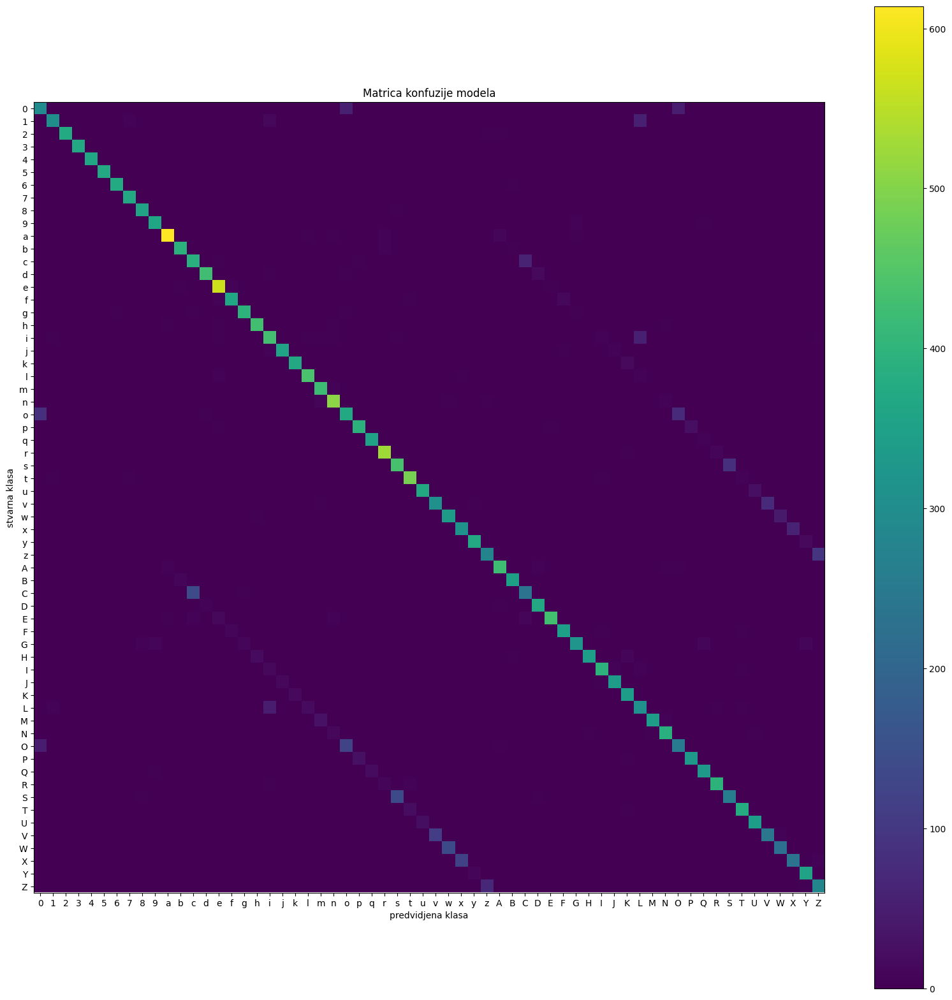

In [63]:
# Ispisujemo matricu konfuzije za naš model
matrix = confusion_matrix(y_test_numeric, y_pred_numeric)
plt.figure(figsize=(20, 20))
plt.imshow(matrix, cmap='viridis')
plt.title('Matrica konfuzije modela')

# Postavljamo oznake za ose
plt.xlabel('predvidjena klasa')
plt.ylabel('stvarna klasa')

# postavljamo imena klasa za svaku kolonu i vrstu
plt.xticks(range(0, NUM_OF_CLASSES), [classes[i] for i in range(0, NUM_OF_CLASSES)])
plt.yticks(range(0, NUM_OF_CLASSES), [classes[i] for i in range(0, NUM_OF_CLASSES)])

plt.colorbar()

# U slučaju da želite da sačuvate sliku matrice otkomentarišite liniju ispod
plt.savefig('architecture2_50epochs_bsize_128_confusion_matrix.png', dpi=300)

plt.show()

In [65]:
# Čuvamo model po potrebi za kasnije ponovno korišćenje
model.save('architecture2_50epochs_bsize_128')

INFO:tensorflow:Assets written to: architecture2_50epochs_bsize_128\assets


In [92]:
# Pomoćni kod za proveru da li se model dobro sačuvao
#loaded_model = keras.models.load_model('architecture1_50epochs_bsize_128/')

In [64]:
# U slučaju da je model prevelik za čuvanje možemo sačuvati samo njegove težine
model.save_weights('architecture2_50epochs_bsize_128_weights/')